# Notebook for the manifold generation of snRNA-Seq mouse data post-`cellbender` using `bbknn+scanpy`

- **Developed by:** Carlos Talavera-López Ph.D
- **Modified by** : Srivalli Kolla
- **Modification date** : 07 May, 2024
- **Institute of Systems Immunology (WüSI) - JMU-Würzburg**
- v230918

## Import required modules

In [1]:
import bbknn
import anndata
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import time
from pywaffle import Waffle
import matplotlib.pyplot as plt

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Set up working environment

In [2]:
sc.settings.verbosity = 3
sc.logging.print_versions()
sc.settings.set_figure_params(dpi = 180, color_map = 'magma', dpi_save = 300, vector_friendly = True, format = 'svg')
timestamp = time.strftime("%d_%m_%Y")

-----
anndata     0.10.5.post1
scanpy      1.9.8
-----
PIL                 10.2.0
annoy               NA
appnope             0.1.4
asttokens           NA
bbknn               1.6.0
cffi                1.16.0
comm                0.2.1
cycler              0.12.1
cython_runtime      NA
dateutil            2.8.2
debugpy             1.8.1
decorator           5.1.1
executing           2.0.1
h5py                3.10.0
igraph              0.10.8
ipykernel           6.29.3
jedi                0.19.1
joblib              1.3.2
kiwisolver          1.4.5
leidenalg           0.10.2
llvmlite            0.42.0
louvain             0.8.1
matplotlib          3.8.3
mpl_toolkits        NA
natsort             8.4.0
numba               0.59.0
numpy               1.26.4
packaging           23.2
pandas              2.2.1
parso               0.8.3
patsy               0.5.6
pickleshare         0.7.5
pkg_resources       NA
platformdirs        4.2.0
plotly              5.21.0
prompt_toolkit      3.0.42
psutil      

## Reading data

In [3]:
adata = sc.read_h5ad('/Users/srivalli/Documents/GitHub/hofmann_dmd/data/heart_mm_nuclei-23-0092_CB_QCed_ctl231123_07_05_2024.raw.h5ad')
adata

AnnData object with n_obs × n_vars = 46266 × 32285
    obs: 'sample', 'genotype', 'batch', 'n_genes', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts_per_cell', 'percent_chrY', 'XIST-counts', 'XIST-percentage', 'gender_check_cov', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'sample_colors'
    layers: 'counts', 'sqrt_norm'

## Preprocessing

### Using sqrt normalization counts for analysis

In [5]:
adata_raw = adata.copy()
adata.X = adata.layers['sqrt_norm'].copy()

### Highly variable gene calculation

In [6]:
adata.layers['counts'] = adata_raw.X.copy()

In [7]:
sc.pp.highly_variable_genes(
    adata,
    flavor = "seurat_v3",
    n_top_genes = 7000,
    layer = "counts",
    batch_key = "sample",
    subset = True
)
adata

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/preprocessing/_highly_variable_genes.py:64: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


AnnData object with n_obs × n_vars = 46266 × 7000
    obs: 'sample', 'genotype', 'batch', 'n_genes', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts_per_cell', 'percent_chrY', 'XIST-counts', 'XIST-percentage', 'gender_check_cov', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'sample_colors', 'hvg'
    layers: 'counts', 'sqrt_norm'

### Dimensionality reduction

In [8]:
sc.pp.pca(adata, n_comps = 50, use_highly_variable = True, svd_solver = 'arpack', random_state = 1712)
sc.pp.neighbors(adata, use_rep = "X_pca", n_neighbors = 50, metric = 'minkowski', random_state = 1786)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:12)
computing neighbors


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:14)


computing UMAP


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/umap/umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

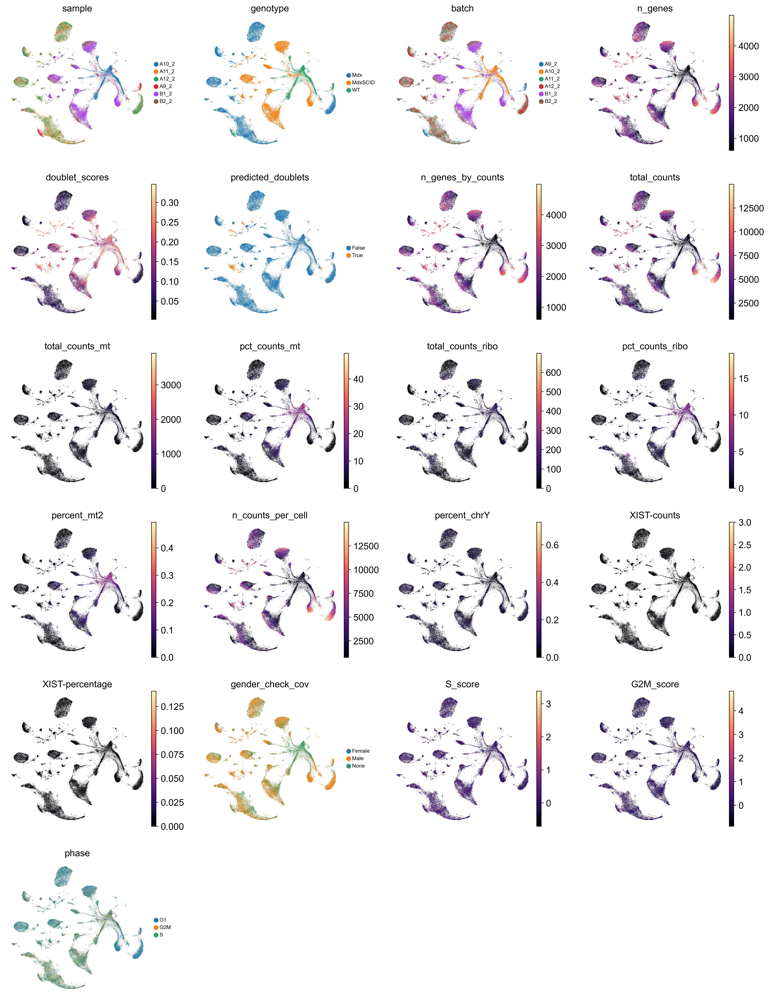

<Figure size 720x720 with 0 Axes>

In [9]:
sc.tl.umap(adata, min_dist = 0.3, spread = 4, random_state = 1789)
sc.pl.umap(adata, frameon = False, color = ['sample', 'genotype', 'batch', 'n_genes', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts_per_cell', 'percent_chrY', 'XIST-counts', 'XIST-percentage', 'gender_check_cov', 'S_score', 'G2M_score', 'phase'], size = 0.8, legend_fontsize = 8, ncols = 4)
plt.savefig(f'before_batch_correction_obs_umap:{timestamp}.svg')

### Batch correction

In [10]:
bbknn_donor = bbknn.bbknn(adata, neighbors_within_batch = 4, batch_key = 'sample', approx = True, copy = True)

computing batch balanced neighbors
	finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)


## Data visualization

### Overall visualization

computing UMAP


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/umap/umap_.py:1393: RuntimeWarning: divide by zero encountered in power
  return 1.0 / (1.0 + a * x ** (2 * b))


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:24)


/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

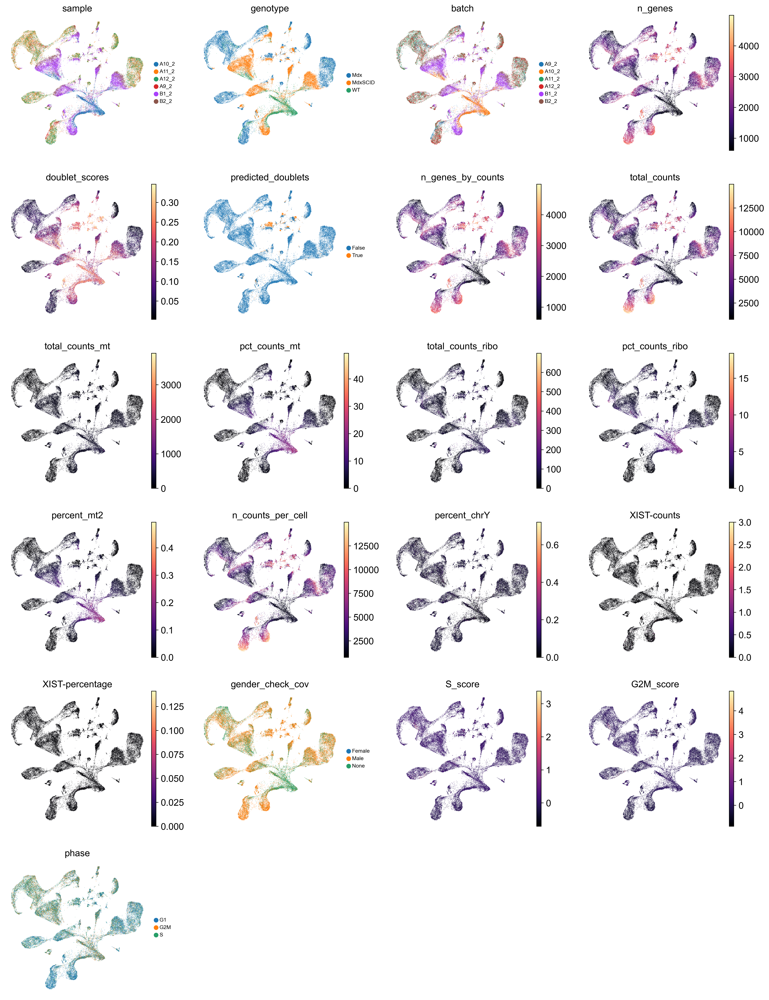

<Figure size 720x720 with 0 Axes>

In [11]:
sc.tl.umap(bbknn_donor, min_dist = 0.3, spread = 4, random_state = 1789)
sc.pl.umap(bbknn_donor, frameon = False, color = ['sample', 'genotype', 'batch', 'n_genes', 'doublet_scores', 'predicted_doublets', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'percent_mt2', 'n_counts_per_cell', 'percent_chrY', 'XIST-counts', 'XIST-percentage', 'gender_check_cov', 'S_score', 'G2M_score', 'phase'], size = 0.8, legend_fontsize = 8, ncols = 4)
plt.savefig(f'after_batch_correction_obs_umap:{timestamp}.svg')

/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/srivalli/conda/envs/scanpy/lib/python3.12/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.ma

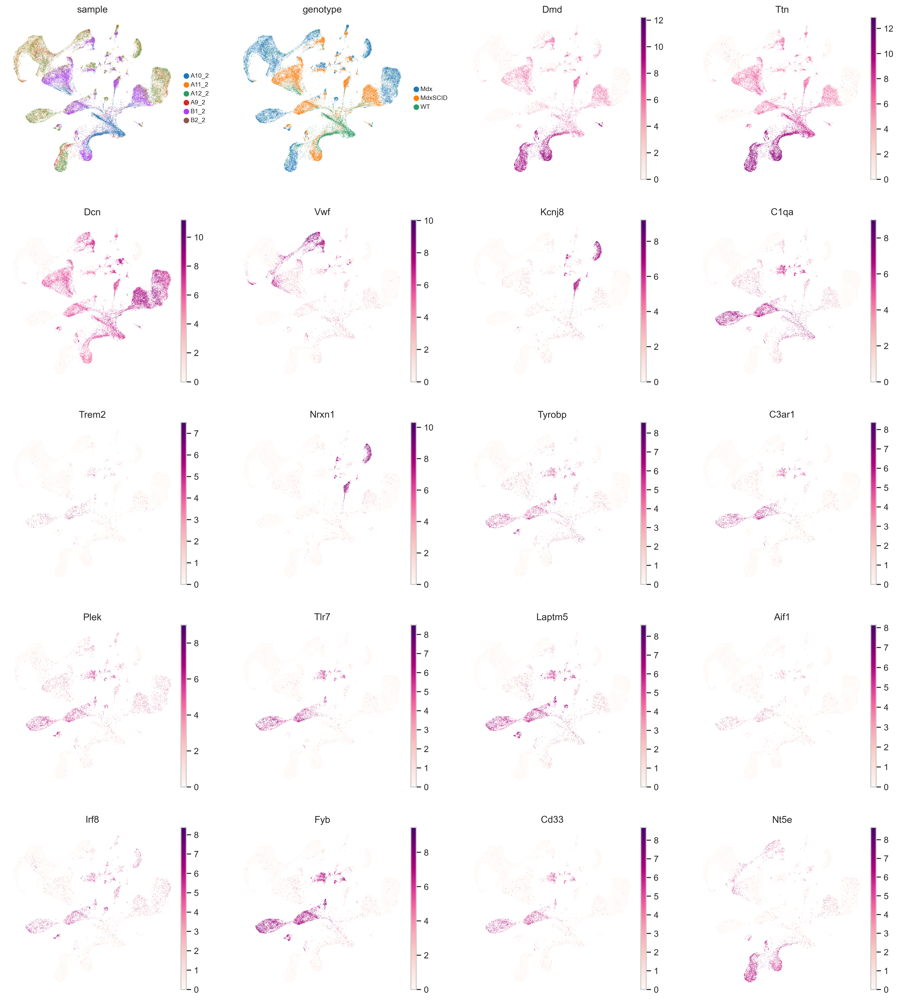

<Figure size 720x720 with 0 Axes>

In [19]:
sc.pl.umap(bbknn_donor, frameon = False, color = ['sample', 'genotype', 'Dmd','Ttn', 'Dcn', 'Vwf', 'Kcnj8', 'C1qa', 'Trem2', 'Nrxn1','Tyrobp','C3ar1','Plek','Tlr7','Laptm5','Aif1','Irf8','Fyb','Cd33','Nt5e'], size = 0.6, legend_fontsize = 8, ncols = 4, cmap = 'RdPu')
plt.savefig(f'batch_corrected_gene_umap:{timestamp}.svg')

### Covariate visualization

#### Doublet score per sample

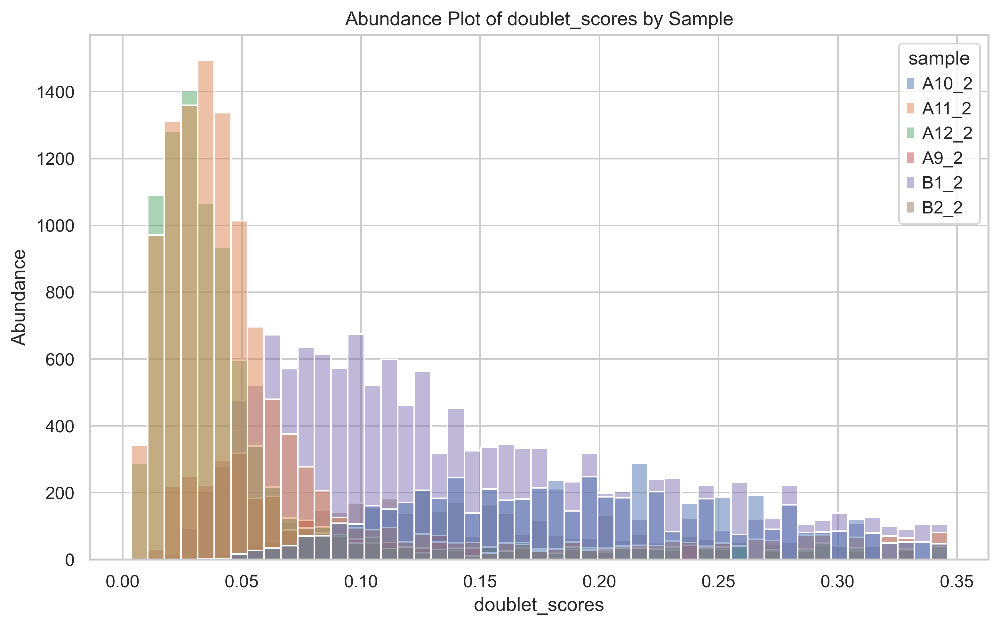

In [13]:
sns.set(style="whitegrid")
covariate_to_visualize = 'doublet_scores'

plt.figure(figsize=(10, 6))
sns.histplot(data=adata.obs, x=covariate_to_visualize, hue='sample', stat='count', common_norm=False)
plt.xlabel(covariate_to_visualize)
plt.ylabel('Abundance')
plt.title(f'Abundance Plot of {covariate_to_visualize} by Sample')
plt.savefig(f'Abundance_Plot_{covariate_to_visualize}_by_Sample:{timestamp}.svg', dpi=300) 
plt.show()

#### Doublet score of each sample

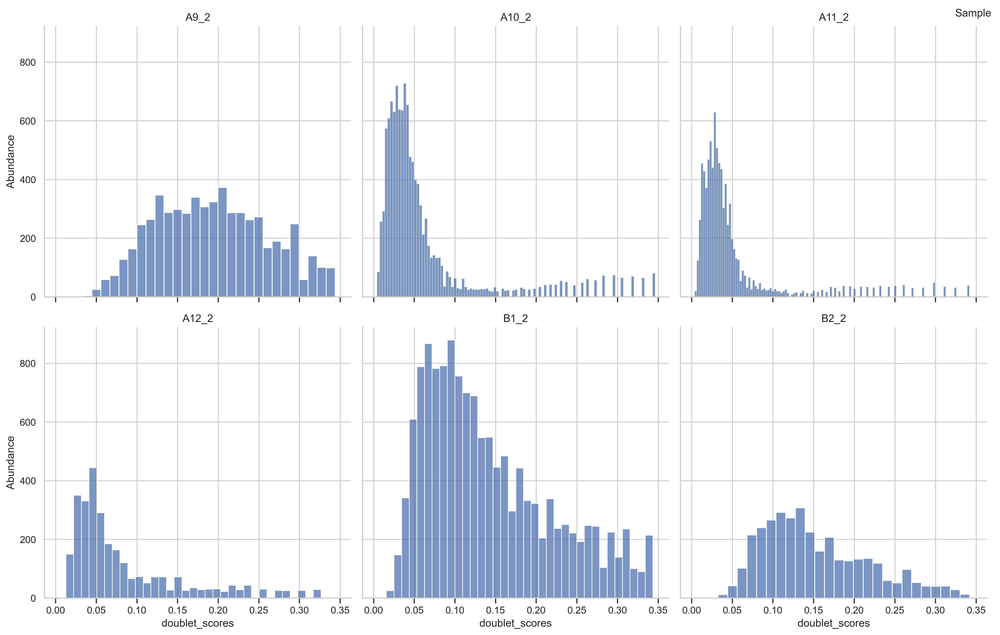

In [14]:
sns.set(style="whitegrid")
covariate_to_visualize = 'doublet_scores'

sample_names = adata.obs['sample'].unique()
num_samples = len(sample_names)
color_palette = sns.color_palette("Set1", n_colors=num_samples)

g = sns.FacetGrid(adata.obs, col="sample", col_wrap=3, height=5, palette=color_palette)
g.map_dataframe(sns.histplot, x=covariate_to_visualize, stat='count', common_norm=False)

g.set_axis_labels(covariate_to_visualize, 'Abundance')
g.set_titles(col_template="{col_name}")
g.add_legend(title='Sample', loc='upper right')

# Set titles for each subplot
for ax, sample_name in zip(g.axes.flat, sample_names):
    ax.set_title(sample_name)
    ax.tick_params(axis='x', which='both', bottom=True)

plt.savefig(f'Abundance_Plot_{covariate_to_visualize}_per_sample:{timestamp}.svg', dpi=300)  
plt.tight_layout()
plt.show()


#### Counts per sample

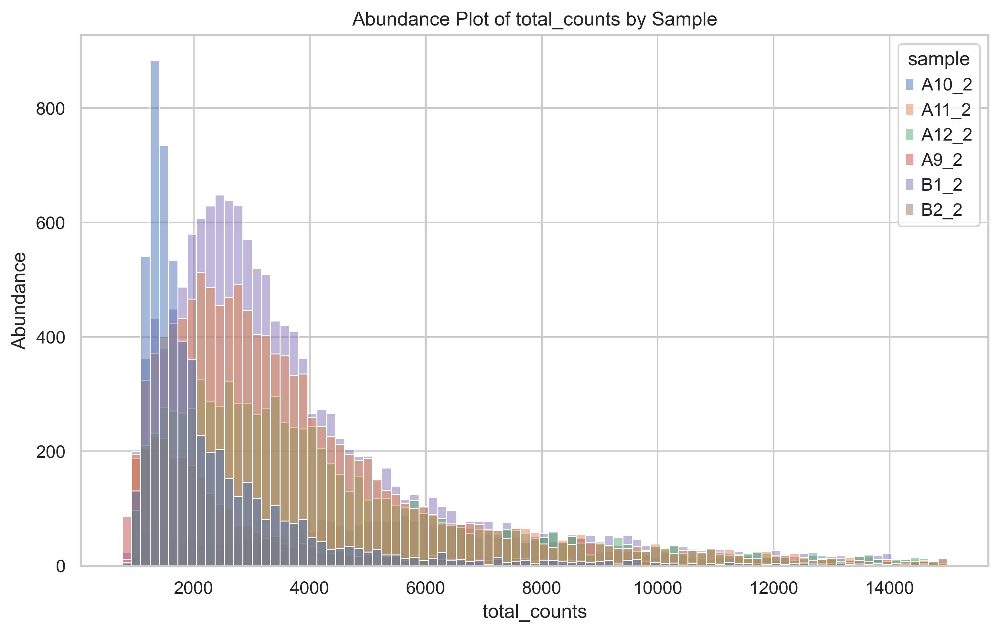

In [15]:
sns.set(style = "whitegrid")
covariate_to_visualize = 'total_counts'

plt.figure(figsize = (10, 6))
sns.histplot(data = adata.obs, x = covariate_to_visualize, hue = 'sample', stat = 'count', common_norm = False)
plt.xlabel(covariate_to_visualize)
plt.ylabel('Abundance')
plt.title(f'Abundance Plot of {covariate_to_visualize} by Sample')
plt.savefig(f'Abundance_Plot_{covariate_to_visualize}_by_Sample:{timestamp}.svg', dpi=300) 
plt.show()

#### UMI plot per cell for sample

#### Steps followed for graph setup

1. Make a variable to store sample names
2. Set num of rows and columns for representation
3. Create a single figure with multiple panels arranged in a grid
4. Flatten the axes array to make it easier to iterate
5. Define a color palette for the lines

#### Steps followed for graph

1. Make a loop through each sample and generate the UMI count plot in a separate panel
2. Making a copy of anndata which is unique to each sample
3. Select umi counts and sort cells by UMI counts in descending order
4. Generate the UMI count plot in the panel created
5. Continues till the graph is generated for all samples
6. Add the graph in the panel and save

/var/folders/m6/j4jl72rj0pl7_bbwngtxl9ym0000gn/T/ipykernel_80428/356685442.py:14: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  color_palette = plt.cm.get_cmap('tab10')


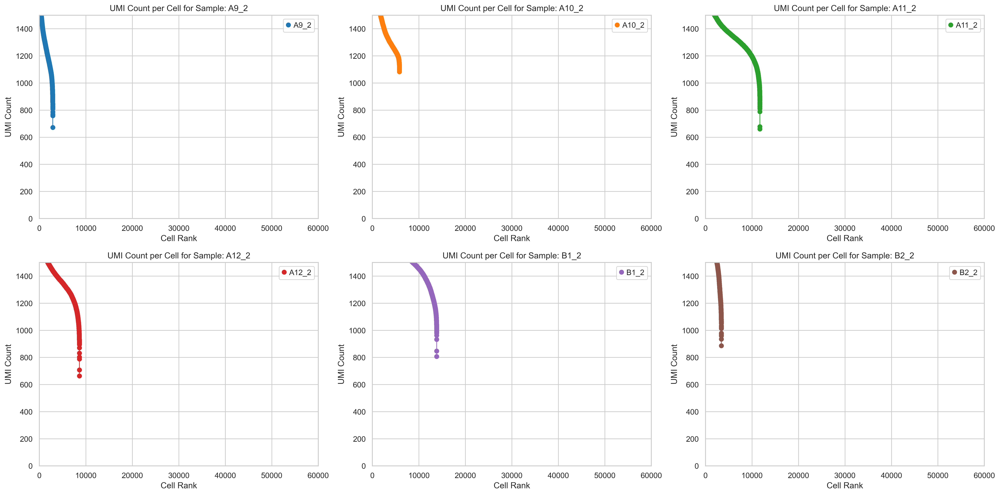

In [16]:
sample_names = adata.obs['sample'].unique()

# Calculate the number of rows and columns for the subplot layout
num_rows = 2
num_cols = 3

# Create a single figure with multiple panels arranged in a grid
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 10))

# Flatten the axs array to make it easier to iterate
axs = axs.flatten()

# Define a color palette for the lines
color_palette = plt.cm.get_cmap('tab10')

# Loop through each sample and generate the UMI count plot in a separate panel
for idx, sample_name in enumerate(sample_names):
    # Select cells belonging to the current sample
    mask = adata.obs['sample'] == sample_name
    sample_adata = adata[mask].copy()

    # Sort cells by UMI counts in descending order
    sample_adata.obs['umi_counts'] = sample_adata.X.sum(axis=1)
    sample_adata = sample_adata[sample_adata.obs['umi_counts'].argsort()[::-1]]

    # Generate the UMI count plot in the current panel
    ax = axs[idx]
    color = color_palette(idx)
    ax.plot(range(1, len(sample_adata) + 1), sample_adata.obs['umi_counts'], marker='o', linestyle='-', label=sample_name, color=color, linewidth=1)
    ax.set_xlabel('Cell Rank')
    ax.set_ylabel('UMI Count')
    ax.set_title(f'UMI Count per Cell for Sample: {sample_name}')
    ax.set_xlim(0, 60000)
    ax.set_ylim(0, 1500)  # Set x-axis limit
    ax.legend()

# Adjust layout and save the figure
plt.tight_layout()

plt.savefig(f'umi_count_subplot_{timestamp}.png')

# Show the figure
plt.show()
